In [ ]:
# @title Importando bibliotecas

import numpy as np
import pandas as pd
import itertools
import shutil
from IPython.display import clear_output
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.utils.class_weight import compute_class_weight


In [ ]:
# @title Importando o dataset

PATH = '/content/drive/MyDrive/Materiais do TCC/Teste YOLO/Projeto Canoas/TCC2'
df = pd.read_csv(PATH + '/keypoints_pose_v1.csv')
df.head()


,image_name,label,nose_x,nose_y,left_eye_x,left_eye_y,right_eye_x,right_eye_y,left_ear_x,left_ear_y,...,right_hip_x,right_hip_y,left_knee_x,left_knee_y,right_knee_x,right_knee_y,left_ankle_x,left_ankle_y,right_ankle_x,right_ankle_y
0,youtuber_11517.png,Caido,0.792430,0.613291,0.799647,0.631989,0.800377,0.603245,0.778640,0.693841,...,0.589738,0.646124,0.543216,0.447671,0.559041,0.439603,0.512550,0.241521,0.528212,0.228444
1,000000439773.jpg,Caido,0.625301,0.288902,0.662422,0.235695,0.596074,0.234829,0.706336,0.238714,...,0.771434,0.262907,0.950526,0.257640,0.871672,0.195308,0.967513,0.120665,0.907647,0.081932
2,055050414.jpg,Caido,0.372103,0.386051,0.373427,0.341881,0.348586,0.367384,0.378351,0.311462,...,0.452212,0.698635,0.715847,0.632951,0.511068,0.862256,0.892082,0.604929,0.735559,0.828270
3,000000494052.jpg,Caido,0.156863,0.411583,0.154728,0.384514,0.141616,0.407594,0.160759,0.347576,...,0.253522,0.449974,0.360880,0.496519,0.314429,0.535502,0.448568,0.583480,0.391605,0.595416
4,img4_853.jpeg,Caido,0.669781,0.656873,0.677087,0.678207,0.685352,0.637484,0.000000,0.000000,...,0.466173,0.459130,0.506871,0.766583,0.385452,0.668150,0.309221,0.786041,0.200879,0.686373


In [ ]:
# @title Verificando se a GPU está disponível

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
# @title Particionando o dataset

# encoder label
encoder = LabelEncoder()
y_label = df['label']
y = encoder.fit_transform(y_label)

# Calculando os pesos das classes
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y), y=y)

# Obter keypoints
X = df.iloc[:, 2:]

# Dividindo o dataset em treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, shuffle=True, random_state=2022)

print("Número de keypoints de treinamento: ", len(X_train))
print("Número de keypoints de teste: ", len(X_test))

# Normalizando os dados
scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)
X_test


Número de keypoints de treinamento:  3519
Número de keypoints de teste:  880


array([[0.590935  , 0.32966991, 0.63799579, ..., 0.65185857, 0.62492911,
        0.9220974 ],
       [0.57444796, 0.37027258, 0.        , ..., 0.7315808 , 0.53085925,
        0.78981954],
       [0.66416382, 0.32023175, 0.6774058 , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.48869215, 0.3328813 , 0.50358429, ..., 0.        , 0.        ,
        0.        ],
       [0.58742928, 0.31285323, 0.59228393, ..., 0.81406796, 0.53644975,
        0.80981004],
       [0.50761381, 0.37157433, 0.52944803, ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
# @title DataLoader

class DataKeypointClassification(Dataset):
    def __init__(self, X, y):
        self.x = torch.from_numpy(X.astype(np.float32))
        self.y = torch.from_numpy(y.astype(np.int64))
        self.n_samples = X.shape[0]

    def __getitem__(self, index):
        return self.x[index], self.y[index]

    def __len__(self):
        return self.n_samples


# Criando os datasets
train_dataset = DataKeypointClassification(X_train, y_train)
test_dataset = DataKeypointClassification(X_test, y_test)


In [ ]:
# @title Montando o Modelo Neural

class NeuralNet(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super(NeuralNet, self).__init__()
        self.l1 = nn.Linear(input_size, hidden_size)
        self.relu = nn.ReLU()
        self.l2 = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        out = self.l1(x)
        out = self.relu(out)
        out = self.l2(out)
        return out


In [ ]:
# @title Funções

def treinamento(model, train_loader, test_loader, num_epoch, criterion, optimizer):
    train_losses = []
    train_acc = []
    test_losses = []
    test_acc = []
    acuracias = []
    iter = 0

    for epoch in range(num_epoch):
        train_correct = 0
        total1 = 0
        running_loss = 0
        for features, labels in train_loader:
            labels = labels.to(device)
            optimizer.zero_grad()
            outputs = model(features)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total1 += labels.size(0)
            if torch.cuda.is_available():
                train_correct += (predicted.cpu() == labels.cpu()).sum()
            else:
                train_correct += (predicted == labels).sum()

        train_accuracy = 100 * train_correct / total1
        train_loss = running_loss / len(train_loader)
        train_acc.append(train_accuracy)
        train_losses.append(train_loss)

        test_loss = 0
        correct = 0
        total = 0
        for features, labels in test_loader:
            labels = labels.to(device)
            outputs = model(features)
            loss_t = criterion(outputs,labels)
            test_loss += loss_t.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            if torch.cuda.is_available():
                correct += (predicted.cpu() == labels.cpu()).sum()
            else:
                correct += (predicted == labels).sum()

        test_loss=test_loss / len(test_loader)
        accuracy = 100 * correct / total
        test_acc.append(accuracy)
        test_losses.append(test_loss)
        acuracias.append(accuracy)

        return train_losses, train_acc, test_losses, test_acc, acuracias


def plotar_graficos(train_losses, train_acc, test_losses, test_acc, num_epoch, nome_arquivo):
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epoch + 1), train_losses, label='Training Loss')
    plt.plot(range(1, num_epoch + 1), test_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epoch + 1), train_acc, label='Training Accuracy')
    plt.plot(range(1, num_epoch + 1), test_acc, label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.savefig(f'{nome_arquivo}_grafico.png')


def salvar_figuras_metricas(encoder, nome_arquivo, X_test, y_test, model):
    # Testando o modelo
    test_features = torch.from_numpy(X_test.astype(np.float32))
    test_labels = y_test
    with torch.no_grad():
        outputs = model(test_features)
        _, predictions = torch.max(outputs, 1)

    # Salvar a classification_report em um arquivo txt
    with open(f'{nome_arquivo}.txt', 'w') as f:
        f.write(classification_report(test_labels, predictions, target_names=encoder.classes_))

    # Matriz de confusão
    cm = confusion_matrix(test_labels, predictions)
    df_cm = pd.DataFrame(
        cm,
        index=encoder.classes_,
        columns = encoder.classes_
    )

    # Salvar a matriz de confusão
    hmap = sns.heatmap(df_cm, annot=True, fmt="d", cmap="Blues")
    plt.ylabel("Surface Ground Truth")
    plt.xlabel("Predicted Surface")
    plt.legend()
    plt.savefig(f'{nome_arquivo}_cm.png')


Treino: 243/242
................................................................................
--- Epoch (training) [60/60]: acc=82.61, loss=0.13290
--- Epoch (validation) [60/60]: val_acc=82.61, val_loss=0.14793


TypeError: unsupported format string passed to list.__format__

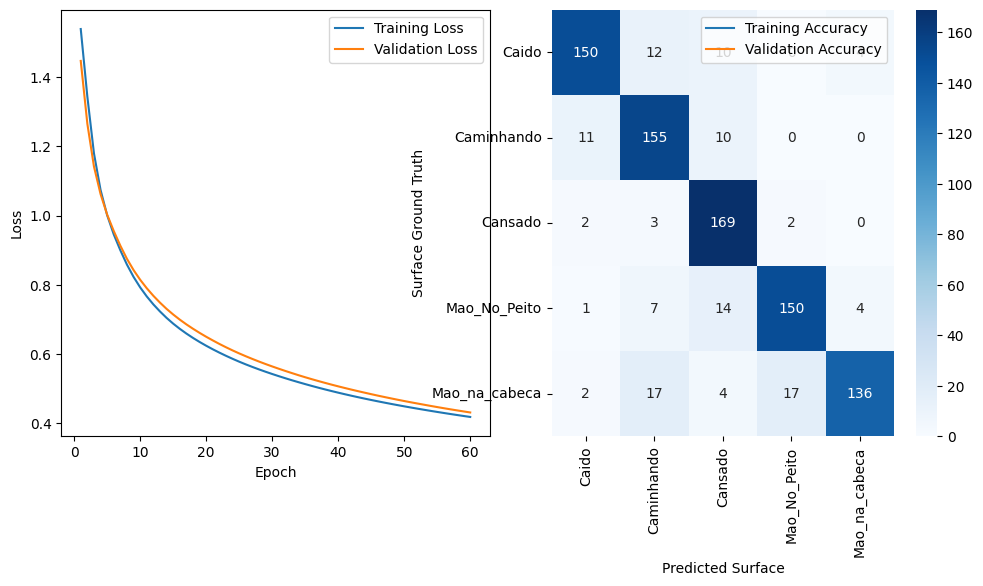

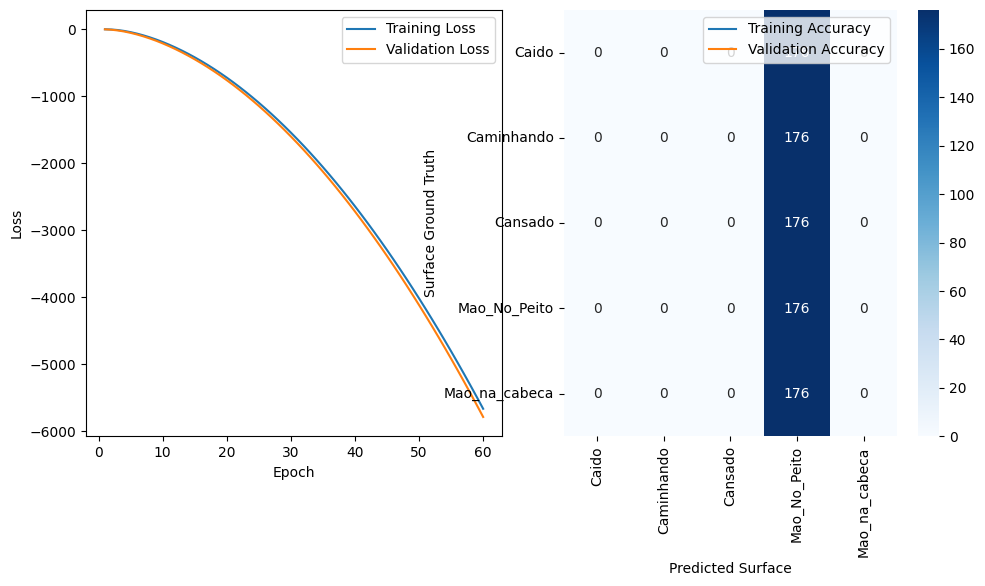

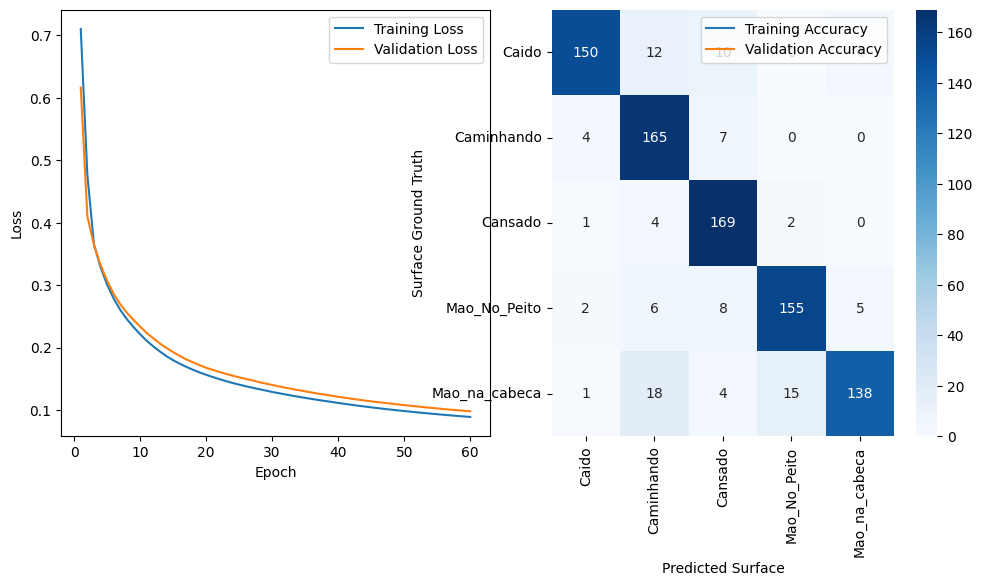

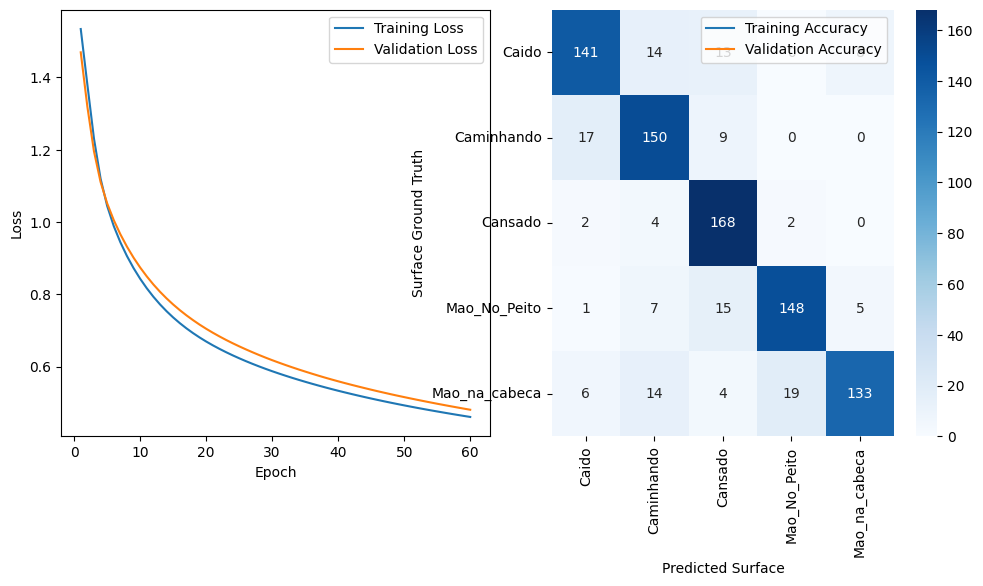

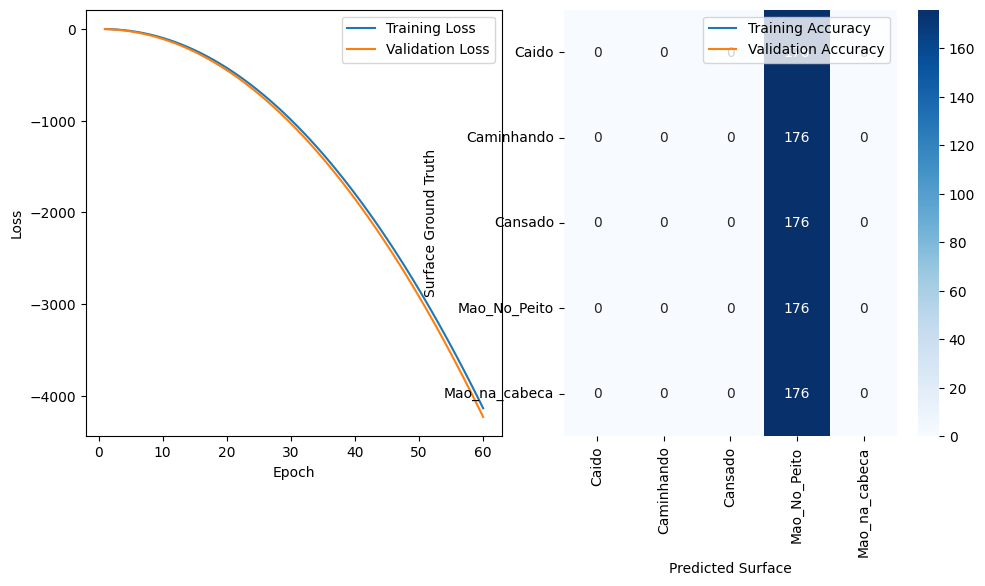

...

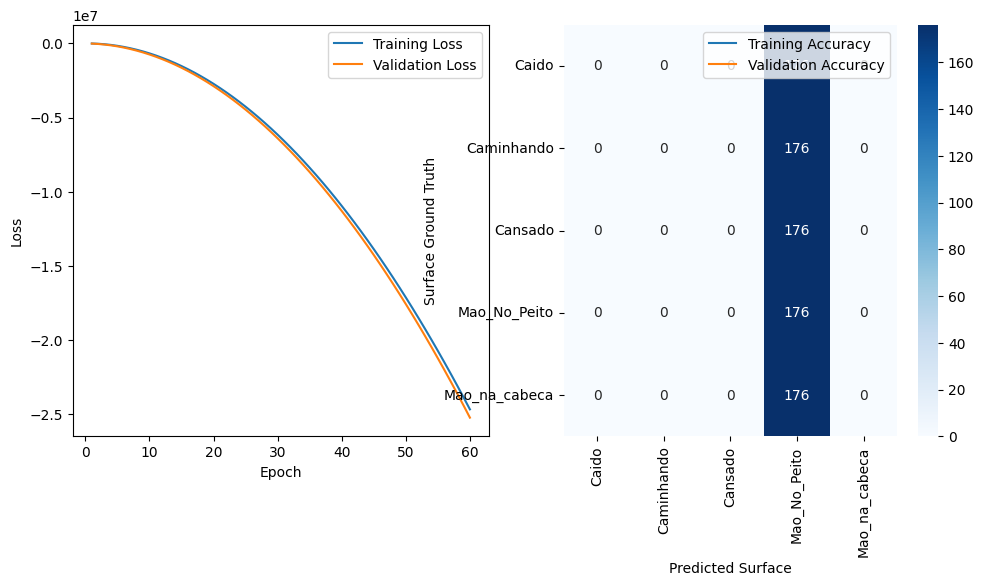

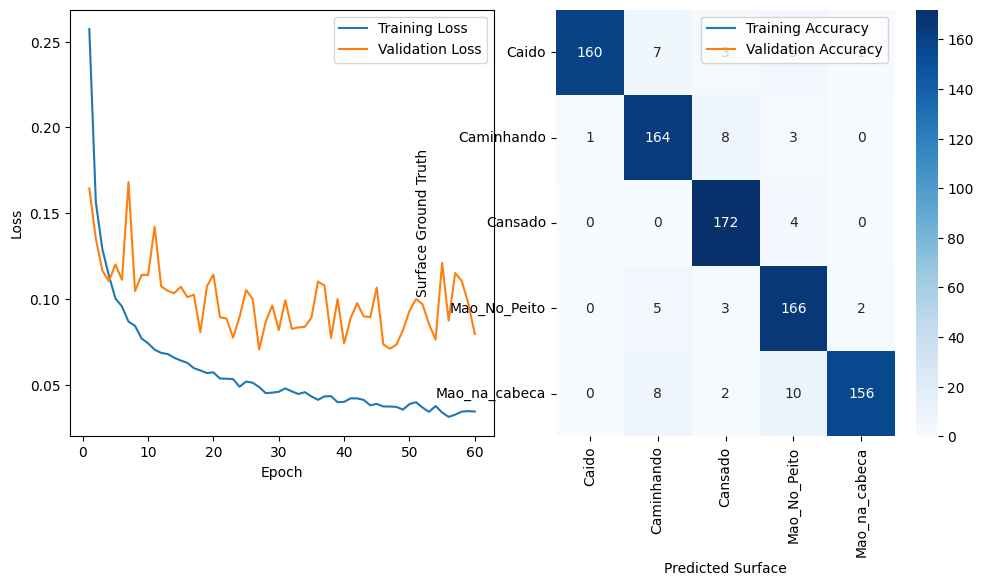

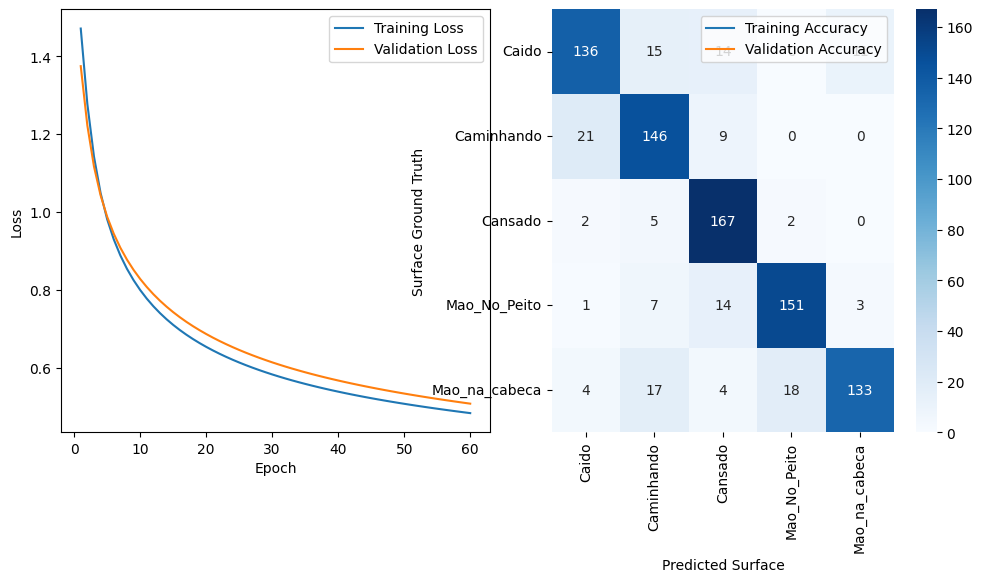

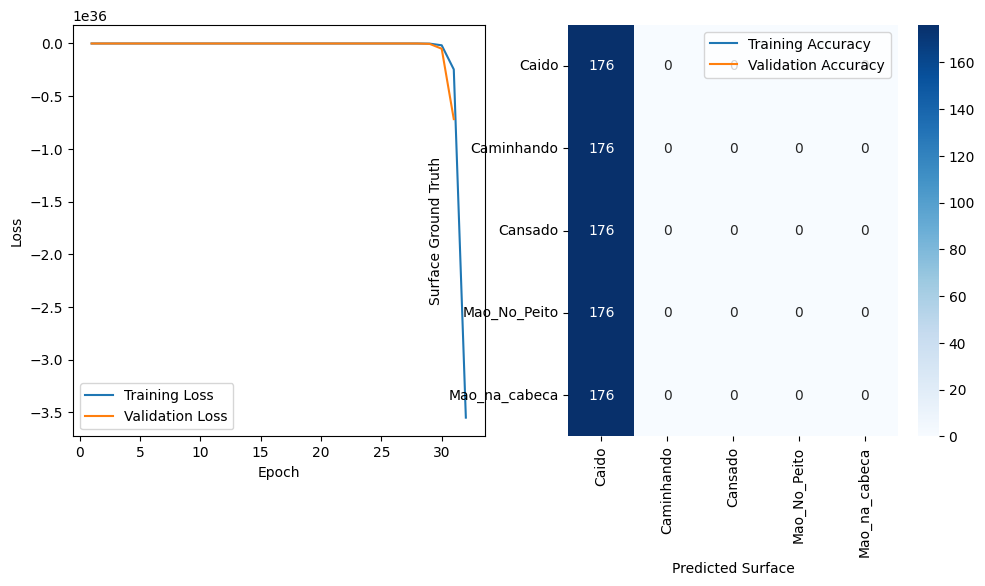

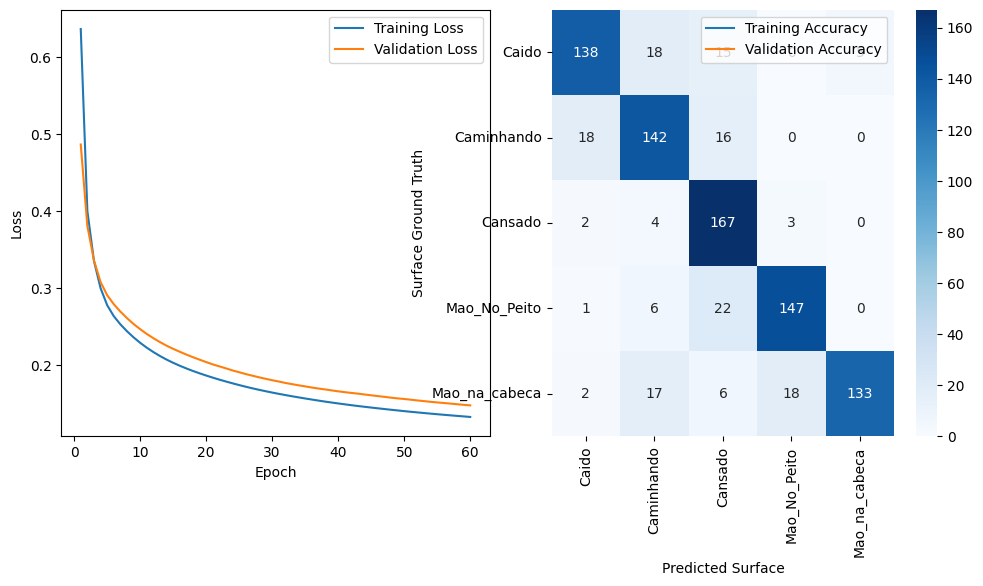

In [ ]:
# @title Buscar melhores parâmetros

# Definindo os hiperparâmetros
hidden_size = [
    64,
    256,
    512
]

learning_rate = [
    0.0001,
    0.001,
    0.01
]

batch_size = [
    8,
    16,
    32
]

optimizer_numbers = [
    0,
    1,
    2
]

criterion = [
    nn.CrossEntropyLoss(weight=torch.from_numpy(class_weights.astype(np.float32))),
    nn.NLLLoss(),
    nn.MultiMarginLoss()
]

# itertools.product() retorna o produto cartesiano de dois iteráveis. Ou seja, ele retorna todas as combinações
# possíveis dos elementos dos dois iteráveis.
combinacoes = itertools.product(hidden_size, learning_rate, batch_size, optimizer_numbers, criterion)

acuracias_validacao = []

tamanho_combinacoes = len(hidden_size) * len(learning_rate) * len(batch_size) * len(optimizer_numbers) * len(criterion)

num_epoch = 60
for indice, combinacao in enumerate(combinacoes, start=1):
    hidden_size, learning_rate, batch_size, optimizer_number, criterion = combinacao

    try:

        # Definindo o modelo
        model = NeuralNet(X_train.shape[1], hidden_size, len(class_weights))

        optimizer = [
            torch.optim.Adam(model.parameters(), lr=learning_rate),
            torch.optim.RMSprop(model.parameters(), lr=learning_rate, alpha=0.9),
            torch.optim.SGD(model.parameters(), lr=learning_rate)
        ]

        optimizer = optimizer[optimizer_number]

        # Criando os dataloaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, num_workers=2)
        test_loader = DataLoader(test_dataset, batch_size=batch_size)

        # ===============================================================================================================
        train_losses = []
        train_acc = []
        test_losses = []
        test_acc = []
        acuracias = []
        iter = 0

        for epoch in range(num_epoch):
            train_correct = 0
            total1 = 0
            running_loss = 0
            for features, labels in train_loader:
                labels = labels.to(device)
                optimizer.zero_grad()
                outputs = model(features)
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()

                running_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                total1 += labels.size(0)
                if torch.cuda.is_available():
                    train_correct += (predicted.cpu() == labels.cpu()).sum()
                else:
                    train_correct += (predicted == labels).sum()

            train_accuracy = 100 * train_correct / total1
            train_loss = running_loss / len(train_loader)
            train_acc.append(train_accuracy)
            train_losses.append(train_loss)

            test_loss = 0
            correct = 0
            total = 0
            for features, labels in test_loader:
                labels = labels.to(device)
                outputs = model(features)
                loss_t = criterion(outputs,labels)
                test_loss += loss_t.item()
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                if torch.cuda.is_available():
                    correct += (predicted.cpu() == labels.cpu()).sum()
                else:
                    correct += (predicted == labels).sum()

            test_loss=test_loss / len(test_loader)
            accuracy = 100 * correct / total
            test_acc.append(accuracy)
            test_losses.append(test_loss)
            acuracias.append([accuracy, train_accuracy])

            # O clear_output(wait=True) limpa a saída da célula atual e mantém a saída da célula anterior.
            clear_output(wait=True)

            print(f'Treino: {indice}/{tamanho_combinacoes}')
            print(f'{"." * 80}\n--- Epoch (training) [{epoch + 1}/{num_epoch}]: acc={train_accuracy:.2f}, loss={train_loss:.5f}')
            print(f'--- Epoch (validation) [{epoch + 1}/{num_epoch}]: val_acc={accuracy:.2f}, val_loss={test_loss:.5f}')

        # ===============================================================================================================

        nome_arquivo = f'combinacao_{indice}'
        plotar_graficos(train_losses, train_acc, test_losses, test_acc, num_epoch, nome_arquivo)
        salvar_figuras_metricas(encoder, nome_arquivo, X_test, y_test, model)

        acuracias_validacao.append(
            (acuracias[-1], nome_arquivo,
             [
                 hidden_size, learning_rate, batch_size, optimizer_number, criterion
                 ]
             )
            )  # Acurácia de val e train da última época, nome do arquivo e parâmetros

        # Salvar o melhor modelo
        nome_arquivo_modelo = f'{nome_arquivo}_modelo.pt'
        torch.save(model.state_dict(), nome_arquivo_modelo)
    except ValueError:
        pass

acuracias_validacao.sort(reverse=True)

for indice, (acuracia, nome_arquivo, parametros) in enumerate(acuracias_validacao, start=1):
    print(f'Acurácia de validação: {acuracia}\nNome do arquivo: {nome_arquivo}\nParâmetros: \n{parametros}\n')


In [ ]:
# Mesmo código, mas sem o erro TypeError: unsupported format string passed to list.__format__

acuracias_validacao.sort(reverse=True)

for indice, (acuracia, nome_arquivo, parametros) in enumerate(acuracias_validacao, start=1):
    print(f'Acurácia de validação: {acuracia}\nNome do arquivo: {nome_arquivo}\nParâmetros: \n{parametros}\n')


Acurácia de validação: [tensor(95.2273), tensor(97.4425)]
Nome do arquivo: combinacao_199
Parâmetros: 
[512, 0.001, 16, 0, CrossEntropyLoss()]

Acurácia de validação: [tensor(94.7727), tensor(97.3856)]
Nome do arquivo: combinacao_111
Parâmetros: 
[256, 0.001, 8, 0, MultiMarginLoss()]

Acurácia de validação: [tensor(94.7727), tensor(97.2719)]
Nome do arquivo: combinacao_201
Parâmetros: 
[512, 0.001, 16, 0, MultiMarginLoss()]

Acurácia de validação: [tensor(94.7727), tensor(97.0730)]
Nome do arquivo: combinacao_192
Parâmetros: 
[512, 0.001, 8, 0, MultiMarginLoss()]

Acurácia de validação: [tensor(94.6591), tensor(96.8173)]
Nome do arquivo: combinacao_210
Parâmetros: 
[512, 0.001, 32, 0, MultiMarginLoss()]

Acurácia de validação: [tensor(94.5455), tensor(96.6752)]
Nome do arquivo: combinacao_208
Parâmetros: 
[512, 0.001, 32, 0, CrossEntropyLoss()]

Acurácia de validação: [tensor(94.4318), tensor(96.6752)]
Nome do arquivo: combinacao_118
Parâmetros: 
[256, 0.001, 16, 0, CrossEntropyLoss()]

In [ ]:
# Movendo os arquivos para uma pasta no drive
import os

arquivos = os.listdir('/content')[1:]
for arquivo in arquivos:
    try:
        caminho = os.path.join('/content', arquivo)
        shutil.move(caminho, '/content/drive/MyDrive/Materiais do TCC/Teste YOLO/Projeto Canoas/TCC2/Resultados da busca de parâmetros')
    except:
        pass
